# Step

### 0. **rir과 각 source를 곱해야 한다. echo_rir은 고정되어 있다** 라고 들었지만(T60 별로 4개 일 것)

- 이 RIR들을 각각 **uniform** 하게 choice해서 각 **clean speech**, **clean echo** (최신곡 5개를 5초로 자르기 (uniform dist))에 적용(곱)

### 1. `s`, `s_rir`, `echo_rir`, `echo`

- `s` 기준으로 SNR 구해서 [ -5 ~ 5 ] 등, `echo*rir`, `echo` 를 SNR scaling

### 2. `s`, `s_rir`, `echo*rir`, `echo`

- 이렇게 만들어진 _rir 들은 scale이 매우 작을 것이다. 따라서 **std(s) / std(s_rir)** 을 구해서 `s_rir`과 `e_rir`에 곱한다. (같은 걸 곱해야 함)
- `s_rir + e_rir = x` 를 구해서 x가 **clipping** 나는지 검사

### 3. `s`, `s_rir`, `e_rir`, `e`, `x` 가 나오면 저장


# RIR mixing기준 sr=16k. 

In [53]:
import glob
import sys, os
import soundfile as sf
from scipy.signal import fftconvolve as conv
import numpy as np
import math
import librosa
import resampy
import time

echo_time = 6

# echo로 사용되는 clean echo를 잘라내기 위한 함수
## path: clean echo의 경로 <- random.choice로 선택
def load_n_chop(path, seconds=echo_time, seed=127):
    wav, sr = librosa.load(path, sr=16000)
    total_len = len(wav)
    target_len = sr * seconds

    # echo, speech를 거르는 용도
    if total_len <= target_len:
        return wav, sr

    # np.random.seed(seed) # for debugging
    start_point = np.random.randint(0, total_len - target_len) # Uniform dist
    chopped_wav = wav[start_point: start_point + target_len]

    return np.array(chopped_wav), sr

# clean speech를 echo에 맞추기 위해 0-padding 하는 함수
## signal must be mono & 16k sr 
def signal_padding(signal, tot_len=echo_time, front_padding=1.5, sr=16000):
    tot_len = int(tot_len*sr)
    fp = int(front_padding*sr)

    if tot_len < fp+len(signal):
        print(f"Target length {echo_time} sec is smaller than padding+signal")
        return
    
    padding = np.zeros(tot_len)
    padding[fp:fp+len(signal)] += signal
    
    return padding

# RIRs를 random하게 불러오는 함수. Return: h_s, h_e
def filter_choice(rir_source_lists, rir_echo_lists):
    h_s, sr = librosa.load(np.random.choice(rir_source_lists), sr=16000)# Uniform dist
    h_e, sr = librosa.load(np.random.choice(rir_echo_lists), sr=16000) 

    return h_s, h_e
  
def check_clipping(signal, th=1.0):
    num_clipped = np.sum(np.abs(signal) > th)
    is_clipped = num_clipped > 0
    
    return is_clipped, num_clipped
    

In [54]:
rir_source_lists = glob.glob('../data/RIR_filters/RIR_samples/*/location*.wav')
rir_echo_lists = glob.glob('../data/RIR_filters/RIR_samples/*/echo*.wav')

clean_speech_lists = glob.glob('/home/nas3/project/2023_LG_HA/data/0402_LG/target_speech/segment/*.wav')
clean_echo_lists = glob.glob('../data/RIR_filters/Clean/cs_*.wav')

# So HARD...
clean_echos = []

clean_echos.append(librosa.load(clean_echo_lists[0], sr=16000)[0])
clean_echos.append(librosa.load(clean_echo_lists[1], sr=16000)[0])
clean_echos.append(librosa.load(clean_echo_lists[2], sr=16000)[0])
clean_echos.append(librosa.load(clean_echo_lists[3], sr=16000)[0])
clean_echos.append(librosa.load(clean_echo_lists[4], sr=16000)[0])

In [55]:
# clean speech 수=225 만큼 iteration
import time
def RIR_mixing(idx):
    # load the RIRs with uniform dist
    h_s, h_e = filter_choice(rir_source_lists, rir_echo_lists)

    # Step 0: Convolve the clean speech and echo with the RIRs
    speech, _ = load_n_chop(clean_speech_lists[idx])
    s = signal_padding(speech) # 5sec
    
######################################### Hard coded part for fast random choice
    wav = clean_echos[np.random.randint(0, 5)]
    total_len = len(wav)
    target_len = 16000 * 6

    # echo, speech를 거르는 용도
    if total_len <= target_len:
        return wav, sr
    
    # np.random.seed(seed) # for debugging
    start_point = np.random.randint(0, total_len - target_len) # Uniform dist
    chopped_wav = wav[start_point: start_point + target_len]

    e = chopped_wav
######################################### Hard coded part for fast random choice
    speech_pow = np.std(s)
    echo_pow = np.std(e)
    e = (speech_pow / echo_pow) * e
    s_rir = conv(s, h_s, mode='full')[:len(s)]
    e_rir = conv(e, h_e, mode='full')[:len(e)]

    # Step 1: SNR Scaling
    ## echo의 SNR을 -5~5dB로 설정
    # SNR = np.random.uniform(-5, 5)
    SNR = np.random.uniform(-10, -5)
    snr_scale = (np.std(s_rir)/np.std(e_rir)) * pow(10, -SNR/20)
    e_rir *= snr_scale
    # e *= snr_scale
    
    # Step 2: Mixing    
    ## clean과 rir간의 scale 조정
    norm_tmp = (np.std(s) / np.std(s_rir)) * 0.8
    speech_SNR = s_rir * norm_tmp
    echo_SNR = e_rir * norm_tmp 
    
    x = echo_SNR + speech_SNR

    # Step 3: Clipping 검사
    is_clipp, num_clipp = check_clipping(x)
    if is_clipp:
        # print(f"Clipping occurs for {num_clipp} times") # clipping너무 많이 나서 끔 ㅜ
        clipp_scaling = np.max(np.abs(x))*0.99
        s /= clipp_scaling
        speech_SNR /= clipp_scaling
        echo_SNR /= clipp_scaling
        e /= clipp_scaling
        x /= clipp_scaling
    
    return s, speech_SNR, echo_SNR, e, x, SNR


# Using multiprocessing
- 이건 random seed가 processor 별로 같게 들어가는지 SNR이 랜덤하지 않아서 못쓰겠다..


In [56]:
# import multiprocessing as mp
# from tqdm import tqdm

# path = '/home/nas3/project/2023_LG_HA/data/0402_LG/target_speech/segment/'
# save_path = '/home/nas3/project/2023_LG_HA/data/240911_AEC_simulation_dataset/'
# save_folder =['clean_speech/', 'speech_rir/', 'echo_rir/', 'clean_echo/', 'mixture/']
# sampling_rate = 16000
# for folder in save_folder:
#     os.makedirs(save_path+folder, exist_ok=True)

# num_workers = mp.cpu_count()  # 최대 CPU 개수 사용 (또는 원하는 숫자로 지정 가능)
# print (num_workers)

# # Function to call in parallel
# def process_rir_mixing(idx):
#     return RIR_mixing(idx)

# if __name__ == "__main__":
#     # Generate list of indices to process
#     indices = list(range(len(clean_speech_lists)))

#     # Create a pool of workers
#     with mp.Pool(num_workers) as pool:
#         # Map the RIR_mixing function to the list of indices
#         results = pool.map(process_rir_mixing, indices)

#     # The results list will contain the output from each RIR_mixing call
#     for i, result in tqdm(enumerate(results), total=len(results)):

#         s, s_rir, e_rir, e, x, SNR = result
#         sf.write(save_path+ save_folder[0] + f'{i}_s.wav',                      s, sampling_rate)
#         sf.write(save_path+ save_folder[1] + f'{i}_SNR_{SNR:.2f}_s_rir.wav',    s_rir, sampling_rate)
#         sf.write(save_path+ save_folder[2] + f'{i}_SNR_{SNR:.2f}_e_rir.wav',    e_rir, sampling_rate)
#         sf.write(save_path+ save_folder[3] + f'{i}_SNR_{SNR:.2f}_e.wav',        e, sampling_rate)
#         sf.write(save_path+ save_folder[4] + f'{i}_SNR_{SNR:.2f}_x.wav',        x, sampling_rate)
#         # You can now work with each result or save it to a file



In [57]:
# 느려서 안쓰려고함(사실 load_chop 할 때 3분짜리 노래 계속 불러와서 그럼)
import time

def start_mixing():
    from tqdm import tqdm   

    path = '/home/nas3/project/2023_LG_HA/data/0402_LG/target_speech/segment/'
    save_path = '/home/nas3/project/2023_LG_HA/data/240911_AEC_simulation_dataset/'
    save_folder =['clean_speech/', 'speech_rir/', 'echo_rir/', 'clean_echo/', 'mixture/']
    
    for folder in save_folder:
        os.makedirs(save_path+folder, exist_ok=True)


    sampling_rate = 16000
    for i, list in tqdm(enumerate(clean_speech_lists), total=len(clean_speech_lists)):
        # folder_name = list.replace(path, '').replace('.wav', '')
        # os.makedirs(save_path + f'{folder_name}', exist_ok=True)

        s, s_rir, e_rir, e, x, SNR = RIR_mixing(i)

        sf.write(save_path+ save_folder[0] + f'{i}_s.wav',                      s, sampling_rate)
        sf.write(save_path+ save_folder[1] + f'{i}_SNR_{SNR:.2f}_s_rir.wav',    s_rir, sampling_rate)
        sf.write(save_path+ save_folder[2] + f'{i}_SNR_{SNR:.2f}_e_rir.wav',    e_rir, sampling_rate)
        sf.write(save_path+ save_folder[3] + f'{i}_SNR_{SNR:.2f}_e.wav',        e, sampling_rate)
        sf.write(save_path+ save_folder[4] + f'{i}_SNR_{SNR:.2f}_x.wav',        x, sampling_rate)

start_mixing()

100%|██████████| 225/225 [01:29<00:00,  2.52it/s]


# Debugging Zone

In [13]:
idx = 3

rir_source_lists[idx],rir_echo_lists[idx],clean_speech_lists[idx],clean_echo_lists[idx]

('../data/RIR_filters/RIR_samples/T60_0.35/location_4.67_2.92_1.12.wav',
 '../data/RIR_filters/RIR_samples/T60_0.3/echo_1.74_1.65_0.15.wav',
 '/home/nas3/project/2023_LG_HA/data/0402_LG/target_speech/segment/001_female_30s_seoul-04.wav',
 '../data/RIR_filters/Clean/cs_4_미안해미워해사랑해.wav')

In [14]:
s, s_sr = sf.read(clean_speech_lists[idx])
s_rir, s_rir_sr = sf.read(rir_source_lists[idx])
e_rir, e_rir_sr = sf.read(rir_echo_lists[idx])
e, e_sr = sf.read(clean_echo_lists[idx])

In [12]:
s_sr, s_rir_sr, e_rir_sr, e_sr

(44100, 16000, 16000, 44100)

In [29]:
import librosa 
signal, sr = librosa.load(clean_speech_lists[idx], sr=16000)

In [30]:
signal.shape, sr

((40688,), 16000)

In [317]:
s, s_rir, e_rir, e, x, SNR = RIR_mixing(1)


In [319]:
display(Audio(x, rate=16000)), SNR

(None, -1.2117645141884834)

In [258]:
from IPython.display import Audio, display

temp, sr = sf.read(clean_speech_lists[10])
display(Audio(temp, rate=44100))
max(temp)

0.3250732421875

In [255]:
temp, sr= load_n_chop(clean_echo_lists[1])
display(Audio(temp, rate=sr))
max(temp)

0.99853515625

In [109]:
temp, sr = sf.read(clean_echo_lists[0])
display(Audio(temp, rate=sr))

In [89]:
import librosa

# 여기서 안걸리면 조건 만족하는 것임
def check_sr(directory):
    for filename in os.listdir(directory):
        if filename.endswith('.wav'):
            filepath = os.path.join(directory, filename)
            try:
                y, sr = librosa.load(filepath, sr=None, mono=False)
                
                # 채널 수 확인
                num_channels = y.shape[0] if y.ndim > 1 else 1

                if sr != 44100 or num_channels != 1:
                    print(f"File '{filename}' has sampling rate {sr} Hz and {num_channels} channels")
            except Exception as e:
                print(f"Could not process file '{filename}': {e}")
                
directory = '/home/nas3/project/2023_LG_HA/data/0402_LG/target_speech/segment/'
check_sr(directory)


- clean speech, clean echo 둘다 44100이니까 그냥 44100으로 만들자

# Mixing된거 함 보자

In [4]:
import matplotlib.pyplot as plt
import librosa
import soundfile as sf
import numpy as np
import glob

path = '/home/nas3/project/2023_LG_HA/data/240911_AEC_simulation_dataset/'
idx = 0

s, sr_1= sf.read(glob.glob(path+f'{idx}*s.wav')[0])
s_rir, sr_2 = sf.read(glob.glob(path+f'{idx}*s_rir.wav')[0])
e_rir, sr_3 = sf.read(glob.glob(path+f'{idx}*e_rir.wav')[0])
e, sr_4 = sf.read(glob.glob(path+f'{idx}*e.wav')[0])
x, sr_5 = sf.read(glob.glob(path+f'{idx}*x.wav')[0])

print(sr_1, sr_2, sr_3, sr_4, sr_5)

16000 16000 16000 16000 16000


In [2]:

def show_spectrogram(input, noise):
    # Spectrogram
    D1 = librosa.amplitude_to_db(np.abs(librosa.stft(input)), ref=np.max)
    D2 = librosa.amplitude_to_db(np.abs(librosa.stft(noise)), ref=np.max)

    # Visualize
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 1, 1)
    librosa.display.specshow(D1, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Input signal')

    plt.subplot(2, 1, 2)
    librosa.display.specshow(D2, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Noise')

    plt.show()

AttributeError: module 'librosa' has no attribute 'display'

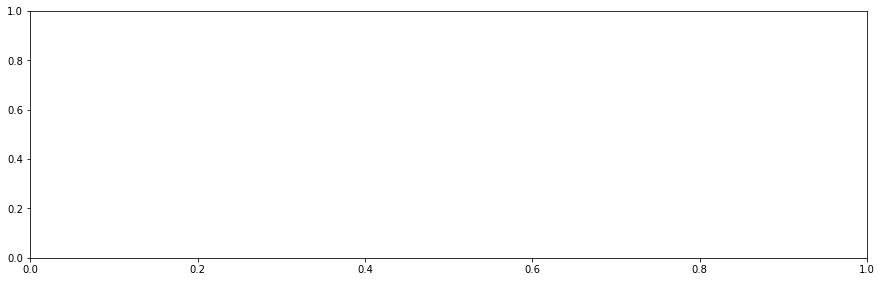

In [3]:
show_spectrogram(s, s_rir)
show_spectrogram(e, e_rir)
show_spectrogram(x, x)

In [59]:
import re 
SNR_arr = []

save_path = '/home/nas3/project/2023_LG_HA/data/240911_AEC_simulation_dataset/'
save_folder =['clean_speech/', 'speech_rir/', 'echo_rir/', 'clean_echo/', 'mixture/']

file_list = []
for folder in save_folder:
    file_list.append(glob.glob(save_path + folder + '*.wav'))
    
for i in range(225):
    match = re.search(r'_SNR_(-?\d+\.\d+)', file_list[4][i])
    if match:
        snr_value = match.group(1)
        SNR_arr.append(snr_value)

In [75]:
import numpy
SNR_arr_float = [float(i) for i in SNR_arr]

numpy.mean(np.abs(numpy.array(SNR_arr_float)))


7.439955555555556